# Ford GoBike Data Exploration

## Preliminary Wrangling

This document explores "Ford GoBike System Data" dataset which includes information about individual rides made in a bike-sharing system covering the greater San Frascisco Bay area.

In [195]:
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import math

%matplotlib inline

In [196]:
# load in the dataset into a pandas dataframe, print statistics
fordgobike_rides = pd.read_csv('201902-fordgobike-tripdata.csv')

In [197]:
# high-level overview of data shape and composition
print(fordgobike_rides.shape)
print(fordgobike_rides.info())
print(fordgobike_rides.head(10))

(183412, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183412 non-null  int64  
 1   start_time               183412 non-null  object 
 2   end_time                 183412 non-null  object 
 3   start_station_id         183215 non-null  float64
 4   start_station_name       183215 non-null  object 
 5   start_station_latitude   183412 non-null  float64
 6   start_station_longitude  183412 non-null  float64
 7   end_station_id           183215 non-null  float64
 8   end_station_name         183215 non-null  object 
 9   end_station_latitude     183412 non-null  float64
 10  end_station_longitude    183412 non-null  float64
 11  bike_id                  183412 non-null  int64  
 12  user_type                183412 non-null  object 
 13  member_birth_year        175147 non-null  floa

In [198]:
# descriptive statistics for numeric variables
print(fordgobike_rides.describe())

        duration_sec  start_station_id  start_station_latitude  \
count  183412.000000     183215.000000           183412.000000   
mean      726.078435        138.590427               37.771223   
std      1794.389780        111.778864                0.099581   
min        61.000000          3.000000               37.317298   
25%       325.000000         47.000000               37.770083   
50%       514.000000        104.000000               37.780760   
75%       796.000000        239.000000               37.797280   
max     85444.000000        398.000000               37.880222   

       start_station_longitude  end_station_id  end_station_latitude  \
count            183412.000000   183215.000000         183412.000000   
mean               -122.352664      136.249123             37.771427   
std                   0.117097      111.515131              0.099490   
min                -122.453704        3.000000             37.317298   
25%                -122.412408       44.00000

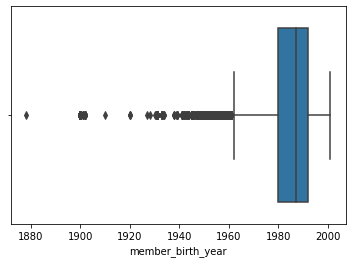

In [199]:
# Check for outliers in birth year column 
sns.boxplot(x=fordgobike_rides['member_birth_year']);

In [200]:
# Check for duplicates
sum(fordgobike_rides.duplicated())

0

### What is the structure of your dataset?

There are 183,412 trips in the dataset with 16 features (duration_sec, start_time, end_time, start_station_id, start_station_name,start_station_latitude, start_station_longitude, end_station_id, end_station_name, end_station_latitude, end_station_longitude, bike_id,
user_type, member_birth_year, member_gender, and bike_share_for_all_trip). Most variables are numeric in nature, but the variables start_station_name, end_station_name, bike_share_for_all_trip, user_type, and member_gender are qualitative.

### What is/are the main feature(s) of interest in your dataset?

I'm most interested in figuring out what features are best for predicting the duration of the trips in the dataset.

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

I expect that distance between start station and end station will have the strongest effect on each trip's duration: the larger the distance, the higher the duration. I also think that user_type, member_age, member_gender, and period of the trip, will have effects on the duration.

> There is some data wrangling needed:
- there are some missing values in member_gender, member_birth_year, start_station_id and end_station_id. Remove these rows.
- there are some incorrect values for example people who born in 1878. There are some outliers regarding the age, people born before 1920. They will be removed as well.
- member_birth_year shoud not be a float. Convert to integer type.
- start_time and end_time should be converted into datetime data type. 
- create a column member_age, based on member_birth_year. I'm interested on knowing if the age affects to the duration of the trips.
- create a new column duration_minute. It could be very useful
- new columns for day of week, month and hour will be created for better insight in the data.
- create a column distance between start station and end station based on coordinates.
- user_type and member_gender should be categories. Convert to category type
- drop unnecessary columns for the analysis.

## Data Wrangling

In [201]:
# create a copy of dataset before cleaning
fordgobike_rides_clean = fordgobike_rides.copy()

In [202]:
# Remove rows with missing values
fordgobike_rides_clean = fordgobike_rides_clean.dropna()
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174952 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             174952 non-null  int64  
 1   start_time               174952 non-null  object 
 2   end_time                 174952 non-null  object 
 3   start_station_id         174952 non-null  float64
 4   start_station_name       174952 non-null  object 
 5   start_station_latitude   174952 non-null  float64
 6   start_station_longitude  174952 non-null  float64
 7   end_station_id           174952 non-null  float64
 8   end_station_name         174952 non-null  object 
 9   end_station_latitude     174952 non-null  float64
 10  end_station_longitude    174952 non-null  float64
 11  bike_id                  174952 non-null  int64  
 12  user_type                174952 non-null  object 
 13  member_birth_year        174952 non-null  float64
 14  memb

In [203]:
# Remove rows with birth dates before 1920
fordgobike_rides_clean = fordgobike_rides_clean[fordgobike_rides_clean['member_birth_year'] > 1920]
assert fordgobike_rides_clean[fordgobike_rides_clean['member_birth_year'] <= 1920].count()[0] == 0

In [204]:
# Convert member_birth_year to integer
fordgobike_rides_clean['member_birth_year'] = fordgobike_rides_clean['member_birth_year'].astype(int)
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174877 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             174877 non-null  int64  
 1   start_time               174877 non-null  object 
 2   end_time                 174877 non-null  object 
 3   start_station_id         174877 non-null  float64
 4   start_station_name       174877 non-null  object 
 5   start_station_latitude   174877 non-null  float64
 6   start_station_longitude  174877 non-null  float64
 7   end_station_id           174877 non-null  float64
 8   end_station_name         174877 non-null  object 
 9   end_station_latitude     174877 non-null  float64
 10  end_station_longitude    174877 non-null  float64
 11  bike_id                  174877 non-null  int64  
 12  user_type                174877 non-null  object 
 13  member_birth_year        174877 non-null  int32  
 14  memb

In [205]:
# modify datetime columns 
time_cols = ['start_time','end_time']
for col in time_cols: 
    fordgobike_rides_clean[col] = pd.to_datetime(fordgobike_rides_clean[col])
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174877 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             174877 non-null  int64         
 1   start_time               174877 non-null  datetime64[ns]
 2   end_time                 174877 non-null  datetime64[ns]
 3   start_station_id         174877 non-null  float64       
 4   start_station_name       174877 non-null  object        
 5   start_station_latitude   174877 non-null  float64       
 6   start_station_longitude  174877 non-null  float64       
 7   end_station_id           174877 non-null  float64       
 8   end_station_name         174877 non-null  object        
 9   end_station_latitude     174877 non-null  float64       
 10  end_station_longitude    174877 non-null  float64       
 11  bike_id                  174877 non-null  int64         
 12  user_type       

In [206]:
# create a new column member_age based on member_birth_year
fordgobike_rides_clean['member_age'] = datetime.now().year - fordgobike_rides_clean['member_birth_year']
fordgobike_rides_clean.describe()

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id,member_birth_year,member_age
count,174877.000000,174877.000000,174877.000000,174877.000000,174877.000000,174877.000000,174877.000000,174877.000000,174877.00000,174877.00000
mean,704.026007,138.980386,37.771206,-122.351758,136.604127,37.771401,-122.351335,4482.533941,1984.83907,36.16093
std,1642.528644,111.636777,0.100409,0.117747,111.333164,0.100313,0.117310,1659.215664,9.97047,9.97047
min,61.000000,3.000000,37.317298,-122.453704,3.000000,37.317298,-122.453704,11.000000,1927.00000,20.00000
25%,323.000000,47.000000,37.770407,-122.411901,44.000000,37.770407,-122.411647,3799.000000,1980.00000,29.00000
50%,510.000000,104.000000,37.780760,-122.398279,101.000000,37.781010,-122.397437,4960.000000,1987.00000,34.00000
75%,789.000000,239.000000,37.797320,-122.283093,238.000000,37.797673,-122.286533,5505.000000,1992.00000,41.00000
max,84548.000000,398.000000,37.880222,-121.874119,398.000000,37.880222,-121.874119,6645.000000,2001.00000,94.00000


In [207]:
# minutes will be very helpful so making a new column
fordgobike_rides_clean['duration_minute'] = fordgobike_rides_clean['duration_sec']/60

In [208]:
# create new column (day of week, day, hour)
fordgobike_rides_clean['start_day_of_week'] = fordgobike_rides_clean['start_time'].dt.day_name().astype('category')
fordgobike_rides_clean['start_hour'] = fordgobike_rides_clean['start_time'].dt.hour
fordgobike_rides_clean['start_month'] = fordgobike_rides_clean['start_time'].dt.month_name().astype('category')
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174877 entries, 0 to 183411
Data columns (total 21 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             174877 non-null  int64         
 1   start_time               174877 non-null  datetime64[ns]
 2   end_time                 174877 non-null  datetime64[ns]
 3   start_station_id         174877 non-null  float64       
 4   start_station_name       174877 non-null  object        
 5   start_station_latitude   174877 non-null  float64       
 6   start_station_longitude  174877 non-null  float64       
 7   end_station_id           174877 non-null  float64       
 8   end_station_name         174877 non-null  object        
 9   end_station_latitude     174877 non-null  float64       
 10  end_station_longitude    174877 non-null  float64       
 11  bike_id                  174877 non-null  int64         
 12  user_type       

In [209]:
def calculate_distance(start_station_latitude, start_station_longitude, end_station_latitude, end_station_longitude):
    # radius of the Earth in Kilometers
    R = 6373.0
    # coordinates
    start_latitude = math.radians(start_station_latitude)
    start_longitude = math.radians(start_station_longitude)
    end_latitude = math.radians(end_station_latitude)
    end_longitude = math.radians(end_station_longitude)
    # change in coordinates    
    dlat = end_latitude - start_latitude
    dlon = end_longitude - start_longitude
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(start_latitude) * math.cos(end_latitude) * math.sin(dlon / 2)**2
    
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = R * c
    return distance

fordgobike_rides_clean['distance'] =  fordgobike_rides_clean.apply(lambda x: calculate_distance(x.start_station_latitude, x.start_station_longitude, x.end_station_latitude, x.end_station_longitude), axis=1)
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174877 entries, 0 to 183411
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             174877 non-null  int64         
 1   start_time               174877 non-null  datetime64[ns]
 2   end_time                 174877 non-null  datetime64[ns]
 3   start_station_id         174877 non-null  float64       
 4   start_station_name       174877 non-null  object        
 5   start_station_latitude   174877 non-null  float64       
 6   start_station_longitude  174877 non-null  float64       
 7   end_station_id           174877 non-null  float64       
 8   end_station_name         174877 non-null  object        
 9   end_station_latitude     174877 non-null  float64       
 10  end_station_longitude    174877 non-null  float64       
 11  bike_id                  174877 non-null  int64         
 12  user_type       

In [210]:
# convert member_gender and user type to Category
fordgobike_rides_clean['user_type'] = fordgobike_rides_clean['user_type'].astype('category')
fordgobike_rides_clean['member_gender'] = fordgobike_rides_clean['member_gender'].astype('category')

In [211]:
unnecessary_cols = ['start_time', 'end_time', 'start_station_id', 'start_station_name','end_station_name','start_station_latitude', 'start_station_longitude', 'end_station_id', 'end_station_latitude', 'end_station_longitude','member_birth_year', 'bike_share_for_all_trip']
fordgobike_rides_clean = fordgobike_rides_clean.drop(columns=unnecessary_cols,axis=1)
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174877 entries, 0 to 183411
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype   
---  ------             --------------   -----   
 0   duration_sec       174877 non-null  int64   
 1   bike_id            174877 non-null  int64   
 2   user_type          174877 non-null  category
 3   member_gender      174877 non-null  category
 4   member_age         174877 non-null  int32   
 5   duration_minute    174877 non-null  float64 
 6   start_day_of_week  174877 non-null  category
 7   start_hour         174877 non-null  int64   
 8   start_month        174877 non-null  category
 9   distance           174877 non-null  float64 
dtypes: category(4), float64(2), int32(1), int64(3)
memory usage: 9.3 MB


In [212]:
# convert start_month, and start_day_of_week into ordered categorical types
ordinal_var_dict = {'start_month': ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'],
                    'start_day_of_week': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']}

for var in ordinal_var_dict:
    ordered_var = pd.api.types.CategoricalDtype(ordered = True,
                                                categories = ordinal_var_dict[var])
    fordgobike_rides_clean[var] = fordgobike_rides_clean[var].astype(ordered_var)

In [213]:
fordgobike_rides_clean.sample(10)

,duration_sec,bike_id,user_type,member_gender,member_age,duration_minute,start_day_of_week,start_hour,start_month,distance
4852,307,4436,Subscriber,Male,29,5.116667,Thursday,14,February,0.751528
26396,570,5802,Subscriber,Male,57,9.500000,Monday,12,February,1.958253
15574,290,5149,Customer,Female,34,4.833333,Wednesday,9,February,1.263711
181510,632,5557,Customer,Male,47,10.533333,Friday,9,February,1.502976
150362,811,5282,Subscriber,Male,27,13.516667,Wednesday,18,February,2.513132
74415,433,6609,Subscriber,Male,26,7.216667,Tuesday,10,February,1.562251
80388,544,6281,Subscriber,Male,39,9.066667,Monday,15,February,1.980292
98874,357,5023,Subscriber,Male,43,5.950000,Friday,5,February,0.943227
25815,321,4369,Subscriber,Male,50,5.350000,Monday,16,February,0.998457
80875,1650,6591,Subscriber,Male,35,27.500000,Monday,14,February,4.147908


### What is the structure of your dataset after wrangling the original one?

There are 174,877 rides in the dataset with 14 features (duration_sec, start_time, end_time, start_station_id, start_station_name,start_station_latitude, start_station_longitude, end_station_id, end_station_name, end_station_latitude, end_station_longitude, bike_id,
user_type, member_birth_year, member_gender, and bike_share_for_all_trip). Most variables are numeric in nature, but the variables start_station_name, end_station_name, bike_share_for_all_trip, user_type, and member_gender are qualitative.

## Univariate Exploration

I'll start by looking at the distribution of the main variable of interest: duration_minute.

In [214]:
#setting the base color
default_color=sns.color_palette()[0]

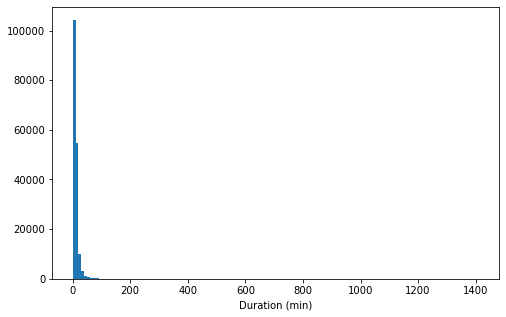

In [215]:
# start with a standard-scaled plot
binsize = 10
bins = np.arange(0, fordgobike_rides_clean['duration_minute'].max()+binsize, binsize)

plt.figure(figsize=[8, 5])
plt.hist(data = fordgobike_rides_clean, x = 'duration_minute', bins = bins)
plt.xlabel('Duration (min)')
plt.show()

There are some outliers. This is the reason why we are going to check the duration of the majority of trips via 99 percentile.

In [216]:
fordgobike_rides_clean['duration_minute'].describe(percentiles=[1])

count    174877.000000
mean         11.733767
std          27.375477
min           1.016667
50%           8.500000
100%       1409.133333
max        1409.133333
Name: duration_minute, dtype: float64

The majority of the trips (99%) have a duration smaller than 53 minutes. Let's adjust the bins and ticks.

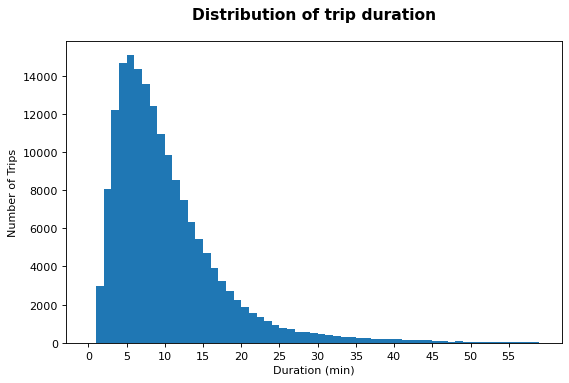

In [217]:
fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')


bins = np.arange(0, 60, 1)
ticks = np.arange(0, 60, 5)
plt.hist(data=fordgobike_rides_clean, x='duration_minute', bins=bins);
plt.xticks(ticks);
plt.xlabel('Duration (min)');
plt.ylabel('Number of Trips')
plt.title('Distribution of trip duration', y=1.05, fontsize=14, fontweight='bold', color = 'black');

Let's remove the outliers from the cleaned dataset

In [218]:
fordgobike_rides_clean = fordgobike_rides_clean.query('duration_minute < 60')
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 173491 entries, 4 to 183411
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype   
---  ------             --------------   -----   
 0   duration_sec       173491 non-null  int64   
 1   bike_id            173491 non-null  int64   
 2   user_type          173491 non-null  category
 3   member_gender      173491 non-null  category
 4   member_age         173491 non-null  int32   
 5   duration_minute    173491 non-null  float64 
 6   start_day_of_week  173491 non-null  category
 7   start_hour         173491 non-null  int64   
 8   start_month        173491 non-null  category
 9   distance           173491 non-null  float64 
dtypes: category(4), float64(2), int32(1), int64(3)
memory usage: 9.3 MB


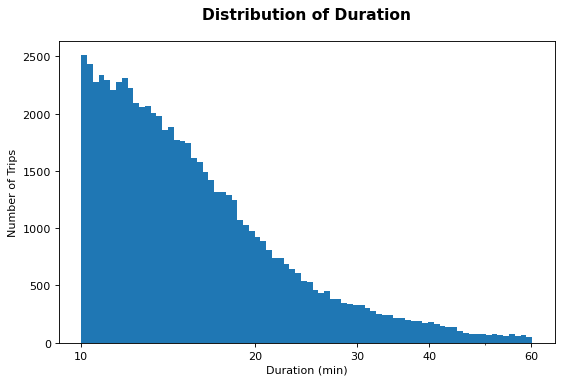

In [219]:
# there's a long tail in the distribution, so let's put it on a log scale instead
log_binsize = 0.01
bins = 10 ** np.arange(1, np.log10(fordgobike_rides_clean['duration_minute'].max())+log_binsize, log_binsize)

fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')

plt.hist(data=fordgobike_rides_clean, x='duration_minute', bins=bins);
plt.xscale('log')
plt.xticks([1e1, 2e1, 3e1, 4e1, 6e1], [10, 20, 30, 40, 60])
plt.xlabel('Duration (min)');
plt.ylabel('Number of Trips')
plt.title('Distribution of Duration', y=1.05, fontsize=14, fontweight='bold', color = 'black');

In [220]:
fordgobike_rides_clean['duration_minute'].describe()

count    173491.000000
mean         10.308134
std           7.396086
min           1.016667
25%           5.350000
50%           8.450000
75%          13.000000
max          59.933333
Name: duration_minute, dtype: float64

Duration has a long-tailed distribution, with a lot of trips on the low duration end, and few on the high duration end. When plotted on a log-scale, the duration distribution looks unimodal, with the highest peak around 10 minutes.

Next up, the first predictor variable of interest: distance.

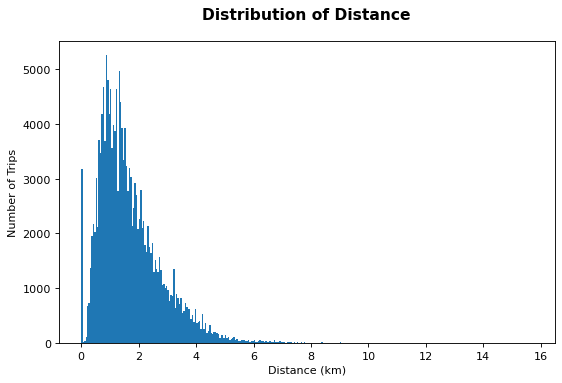

In [221]:
# plotting distance on a standard scale
fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')
binsize = 0.05
bins = np.arange(0, fordgobike_rides_clean['distance'].max()+binsize, binsize)

plt.hist(data=fordgobike_rides_clean, x='distance', bins=bins);
#plt.xticks(ticks);
plt.xlabel('Distance (km)');
plt.ylabel('Number of Trips')
plt.title('Distribution of Distance', y=1.05, fontsize=14, fontweight='bold', color = 'black');

There are some outliers related to distance too. This is the reason why we are going to check the distance of the majority of trips via 99 percentile.

In [222]:
fordgobike_rides_clean['distance'].describe(percentiles=[.99])

count    173491.000000
mean          1.691258
std           1.080969
min           0.000000
50%           1.430370
99%           5.049936
max          15.678876
Name: distance, dtype: float64

The majority of the trips (99%) have a distance smaller than 6 kilometers. Also, there are some outliers points with a distance of 0 kilometers. Let's adjust the bins.

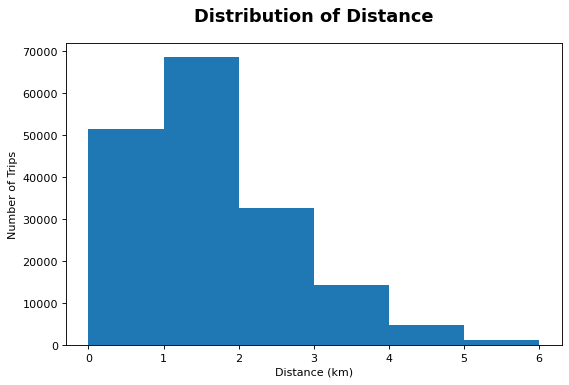

In [223]:
# plotting distance on a standard scale
fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')
binsize = 0.05
bins = np.arange(0, fordgobike_rides_clean['distance'].max()+binsize, binsize)


bins = np.arange(0, 7, 1)
plt.hist(data=fordgobike_rides_clean, x='distance', bins=bins);
plt.xlabel('Distance (km)');
plt.ylabel('Number of Trips')
plt.title('Distribution of Distance', y=1.05, fontsize=16, fontweight='bold', color = 'black');

Let's remove the outliers related to distance too.

In [224]:
fordgobike_rides_clean = fordgobike_rides_clean.query('distance > 0 & distance < 6')
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 169624 entries, 4 to 183411
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype   
---  ------             --------------   -----   
 0   duration_sec       169624 non-null  int64   
 1   bike_id            169624 non-null  int64   
 2   user_type          169624 non-null  category
 3   member_gender      169624 non-null  category
 4   member_age         169624 non-null  int32   
 5   duration_minute    169624 non-null  float64 
 6   start_day_of_week  169624 non-null  category
 7   start_hour         169624 non-null  int64   
 8   start_month        169624 non-null  category
 9   distance           169624 non-null  float64 
dtypes: category(4), float64(2), int32(1), int64(3)
memory usage: 9.1 MB


The distribution of trip distance is right skewed and it has unimodal shape, being the most frequent distance between 1 and 2 kilometers.
Next up, the first predictor variable of interest: member_age.

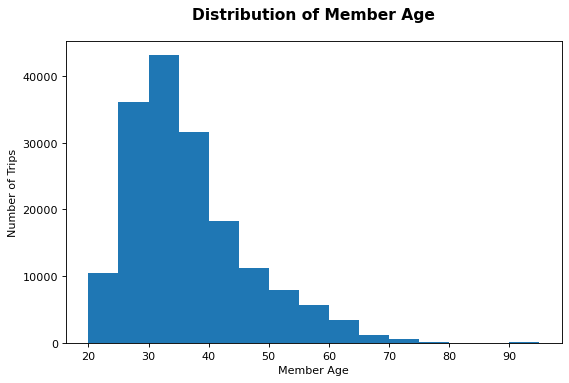

In [225]:
# plotting distance on a standard scale
fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')
binsize = 5
bins = np.arange(fordgobike_rides_clean['member_age'].min(), fordgobike_rides_clean['member_age'].max()+binsize, binsize)


plt.hist(data=fordgobike_rides_clean, x='member_age', bins=bins);
plt.xlabel('Member Age');
plt.ylabel('Number of Trips')
plt.title('Distribution of Member Age', y=1.05, fontsize=14, fontweight='bold', color = 'black');

There are some outliers related to member_age. Let's figure out them.

In [226]:
fordgobike_rides_clean['member_age'].describe(percentiles=[.99])

count    169624.000000
mean         36.146954
std           9.926180
min          20.000000
50%          34.000000
99%          65.000000
max          94.000000
Name: member_age, dtype: float64

The majority of the trips (99%) are done by members with an age lower than 65 years old. Let's remove the outliers and plot the distribution again.

In [227]:
fordgobike_rides_clean = fordgobike_rides_clean.query('member_age <= 65')
fordgobike_rides_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 167970 entries, 4 to 183411
Data columns (total 10 columns):
 #   Column             Non-Null Count   Dtype   
---  ------             --------------   -----   
 0   duration_sec       167970 non-null  int64   
 1   bike_id            167970 non-null  int64   
 2   user_type          167970 non-null  category
 3   member_gender      167970 non-null  category
 4   member_age         167970 non-null  int32   
 5   duration_minute    167970 non-null  float64 
 6   start_day_of_week  167970 non-null  category
 7   start_hour         167970 non-null  int64   
 8   start_month        167970 non-null  category
 9   distance           167970 non-null  float64 
dtypes: category(4), float64(2), int32(1), int64(3)
memory usage: 9.0 MB


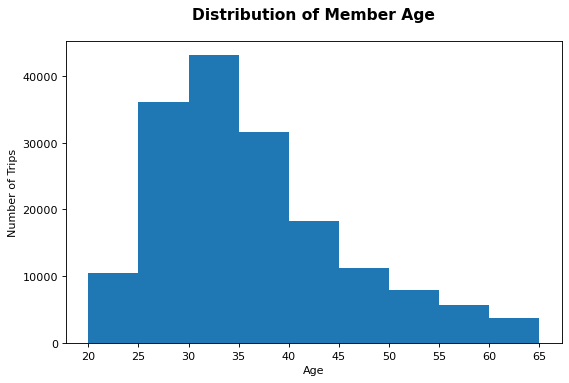

In [228]:
# plotting member_age on a standard scale
fig=plt.figure(figsize=(8,5), dpi= 80, facecolor='w', edgecolor='k')
binsize = 5
bins = np.arange(fordgobike_rides_clean['member_age'].min(), fordgobike_rides_clean['member_age'].max()+binsize, binsize)

plt.hist(data=fordgobike_rides_clean, x='member_age', bins=bins);
plt.xticks(bins);
plt.xlabel('Age');
plt.ylabel('Number of Trips')
plt.title('Distribution of Member Age', y=1.05, fontsize=14, fontweight='bold', color = 'black');

The distribution of member age is right skewed and it has unimodal shape. The most frequent range of member age is between 25 and 45 years old.

I'll now move on to the categorical variables related to the start period of the trip in the dataset: start_month, start_day_of_week, and start_hour.

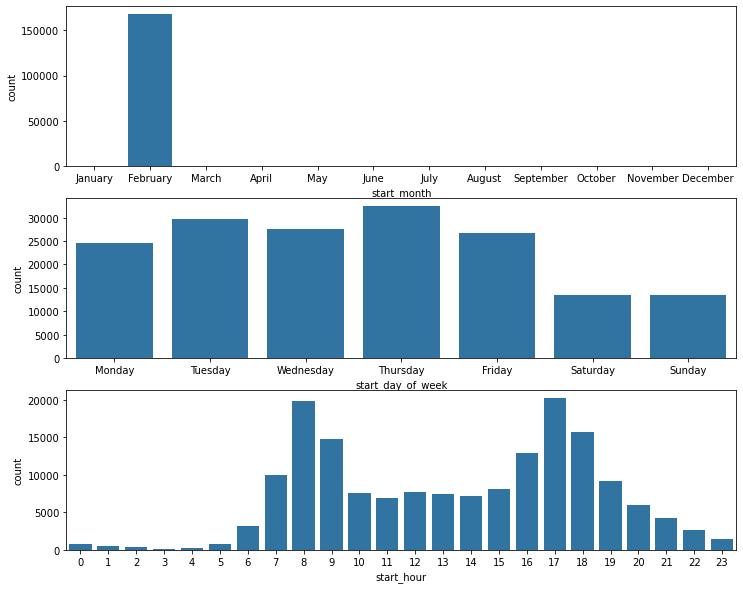

In [229]:
# let's plot all three together to get an idea of each ordinal variable's distribution.

fig, ax = plt.subplots(nrows=3, figsize = [12,10])

sns.countplot(data = fordgobike_rides_clean, x = 'start_month', color = default_color, ax = ax[0])
sns.countplot(data = fordgobike_rides_clean, x = 'start_day_of_week', color = default_color, ax = ax[1])
sns.countplot(data = fordgobike_rides_clean, x = 'start_hour', color = default_color, ax = ax[2])

plt.show();

* The dataset only contains information of trips in February.
* The number of trips is higher in weekdays than in weekends
* Thursday is the day with the highest number of trips.
* Monday is the weekday with the lowest amount of trips.
* There are two peaks of usage. The first one is at 8 AM and the second one is at 5 PM.
* The intervals with the largest number of trips are:
  - between 7AM and 10AM (both included)
  - between 4PM and 6PM (both included)
* It seems that the main usage of the service is for commuting.

I'll now move on to the categorical variables related to the member characteristics in the dataset: user_type, and member_gender.

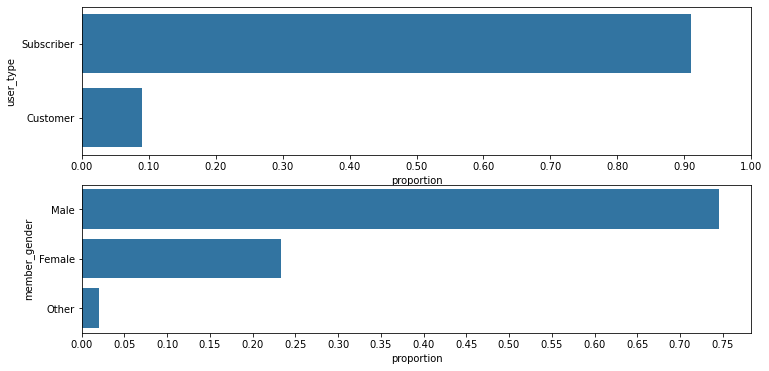

In [230]:
fig, ax = plt.subplots(nrows=2, figsize = [12,6])

user_type_counts = fordgobike_rides_clean['user_type'].value_counts()
user_type_order = user_type_counts.index
n_user_type = fordgobike_rides_clean['user_type'].value_counts().sum()
max_user_type_count = user_type_counts[0]
max_user_type_prop = max_user_type_count / n_user_type
user_type_tick_props = np.arange(0, max_user_type_prop+0.1, 0.1)
user_type_tick_names = ['{:0.2f}'.format(v) for v in user_type_tick_props]

sns.countplot(data = fordgobike_rides_clean, y = 'user_type', order=user_type_order, color = default_color, ax = ax[0])
plt.sca(ax[0])
plt.xticks(user_type_tick_props * n_user_type, user_type_tick_names)
plt.xlabel('proportion')

member_gender_counts = fordgobike_rides_clean['member_gender'].value_counts()
member_gender_order = member_gender_counts.index
n_member_gender = member_gender_counts.sum()
max_member_gender_count = member_gender_counts[0]
max_member_gender_prop = max_member_gender_count / n_member_gender
member_gender_tick_props = np.arange(0, max_member_gender_prop+0.05, 0.05)
member_gender_tick_names = ['{:0.2f}'.format(v) for v in member_gender_tick_props]


sns.countplot(data = fordgobike_rides_clean, y = 'member_gender', order=member_gender_order, color = default_color, ax = ax[1])
plt.sca(ax[1])
plt.xticks(member_gender_tick_props * n_member_gender, member_gender_tick_names)
plt.xlabel('proportion')

plt.show();

* Around 90% of the users are Subscriber and less than 10% are Customer
* The majority of the users are Male (around 75%) and around 24% of users are Female. Only around 1% that are Other gender.

In [231]:
# save it as csv file
fordgobike_rides_clean.to_csv('fordgobike_master.csv', index=False)

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

The duration_minute variable took on a large range of values, I detected that there were outliers. Since 99% of trips had a duration lower than 60 minutes, I decided to remove them from the dataset for safety reasons. Also, I looked at the data using a log transform and the data looked unimodal. The peak is around 10 minutes.

### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

When I was investigating distance and member_age variables, I identified a number of outlier points related to both variables. I decided to remove the outliers points from the dataset to move forwards and for safety reasons. 
I included as part of the data wrangling to order categorically start_day_of_week and start_month variables, for cleaner visualizations.

## Bivariate Exploration

To start off with, I want to look at the pairwise correlations present between features in the data.

In [232]:
numeric_vars = ['duration_minute', 'distance', 'member_age']
member_categoric_vars = ['user_type', 'member_gender']
trip_period_categoric_vars = ['start_day_of_week', 'start_hour']

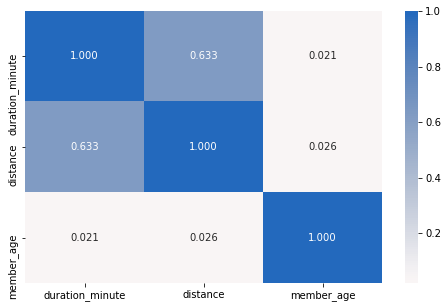

In [233]:
# correlation plot
plt.figure(figsize = [8, 5])
sns.heatmap(fordgobike_rides_clean[numeric_vars].corr(), annot = True, fmt = '.3f',
           cmap = 'vlag_r', center = 0)
plt.show()

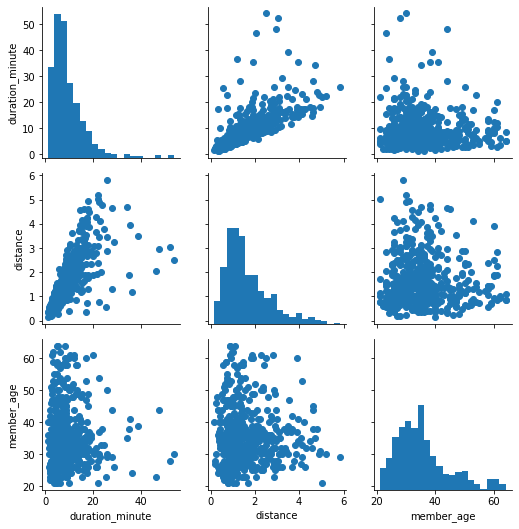

In [234]:
fordgobike_rides_clean_samp = fordgobike_rides_clean.sample(500, replace=False)

g = sns.PairGrid(data = fordgobike_rides_clean_samp, vars = numeric_vars)
g = g.map_diag(plt.hist, bins = 20);
g.map_offdiag(plt.scatter)
plt.show();

As expected, 'duration_minute' and 'distance' are positive correlated. So, when the duration of the trip increases the distance will increase as well. However, I expected that a stronger correlation that the current one. On the other hand, 'member_age' isn't correlated with 'duration_minute' and 'distance' variables.

Let's move on to looking at how duration, distance and member age correlate with the categorical variables related to member characteristics (user_type and member_age).

<Figure size 720x576 with 0 Axes>

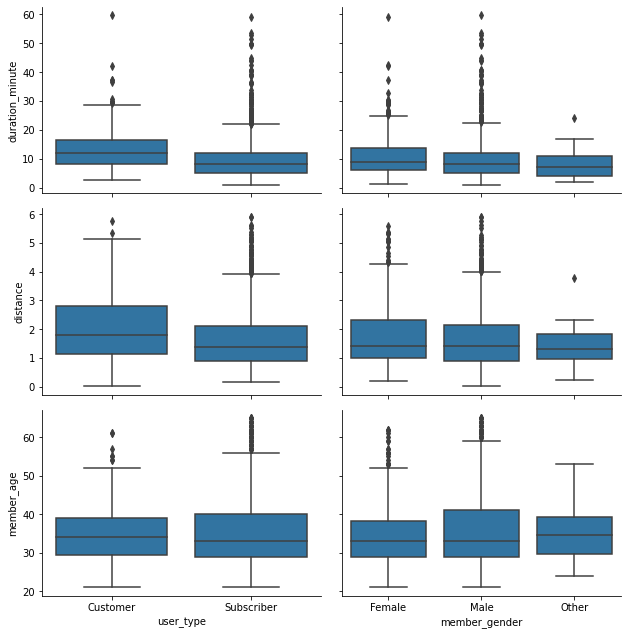

In [235]:
# plot matrix of numeric features against categorical features.
# can use a larger sample since there are fewer plots and they're simpler in nature.
fordgobike_rides_clean_samp = fordgobike_rides_clean.sample(2000, replace=False)

def boxgrid(x, y, **kwargs):
    """ Quick hack for creating box plots with seaborn's PairGrid. """
    default_color = sns.color_palette()[0]
    sns.boxplot(x=x, y=y, color = default_color)

plt.figure(figsize = [10, 8])
g = sns.PairGrid(data = fordgobike_rides_clean_samp, y_vars = ['duration_minute', 'distance', 'member_age'], x_vars = member_categoric_vars, height = 3, aspect = 1.5)
g.map(boxgrid)
plt.show();

There are some relationships between the member categorical variables and the numeric variables of interest. Subscribers made shorter trip than customer in duration and in distance. Also, subscribers seem to be older than customers. Regarding member gender, the relationships are very similar. Females made slightly larger trips than males. However, males seems to be slightly older than females.

Finally, let's look at relationships between user_type and trip period categorical features.

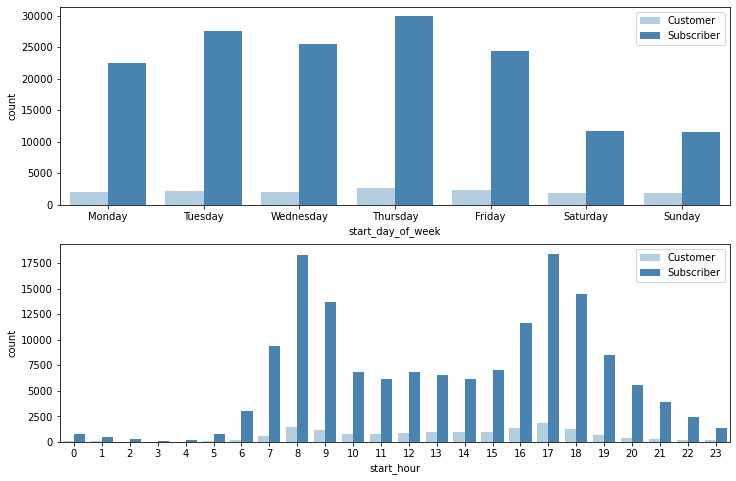

In [236]:
# since there's only three subplots to create, using the full data should be fine.
plt.figure(figsize = [12, 8])

# subplot 1: start_day_of_week vs user_type
ax = plt.subplot(2, 1, 1)
sns.countplot(data = fordgobike_rides_clean, x = 'start_day_of_week', hue = 'user_type', palette = 'Blues')
ax.legend(loc = 1, ncol = 1)

# subplot 2: start_hour vs. user_type
ax = plt.subplot(2, 1, 2)
sns.countplot(data = fordgobike_rides_clean, x = 'start_hour', hue = 'user_type', palette = 'Blues')
ax.legend(loc = 1, ncol = 1) # re-arrange legend to reduce overlapping

plt.show()

Subscribers made their trips mainly over weekdays, the peak is on Thursdays. However, Customers trips are distributed in a similar way through whole the week.

Subscriber's trips are more frequent from 7am till 9am and from 4pm till 6pm which correspond to commute times. Customer's trips are distributed mainly over the 7am and 7pm and the frequency is similar. There is a peak at 5pm, however it doesn't seem that customers use the service for commuting to work.

With the preliminary look at bivariate relationships out of the way, I want to dig into some of the relationships more. First, I want to  compare how duration and distance are related for all of the data.

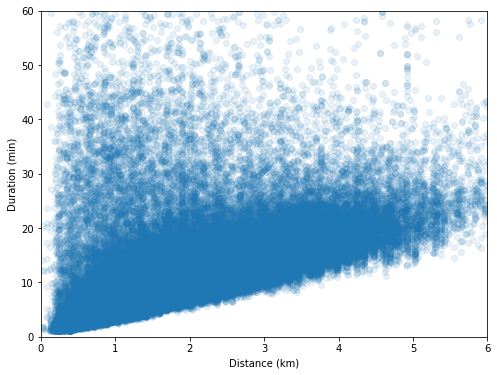

In [237]:
# scatter plot of duration vs. distance

plt.figure(figsize = [8, 6])
plt.scatter(data = fordgobike_rides_clean, x = 'distance', y = 'duration_minute', alpha = 1/10)
plt.ylim([0, 60])
plt.xlim([0, 6])

plt.xlabel('Distance (km)')
plt.ylabel('Duration (min)')
plt.show()

This plot suggests that there is a positive correlation between the trip duration and the trip distance. As the trip duration increases the trip distance will increase too.

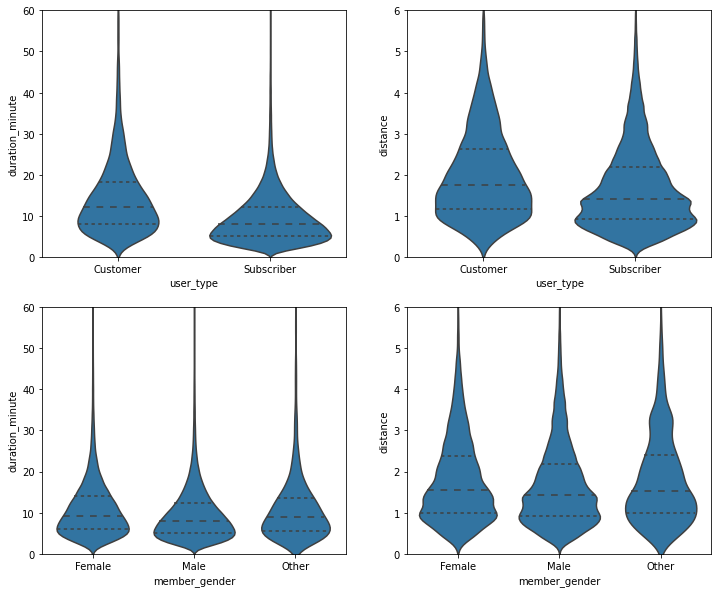

In [238]:
# plot the categorical variables against duration and distance again, this time with full data
fig, ax = plt.subplots(ncols = 2, nrows = 2 , figsize = [12,10])

for i in range(len(member_categoric_vars)):
    var = member_categoric_vars[i]
    sns.violinplot(data = fordgobike_rides_clean, x = var, y = 'duration_minute', ax = ax[i,0], color = default_color, inner='quartile')
    ax[i,0].set_ylim([0, 60])

    sns.violinplot(data = fordgobike_rides_clean, x = var, y = 'distance', ax = ax[i,1],
               color = default_color, inner='quartile')
    ax[i,1].set_ylim([0, 6])
plt.show()

The plot of the full data using a violin plot reveals more or less the same than the earlier box plots. It is highly suggested that subscribers made shorter trips than customers in terms on duration and distance. Regarding member gender, the plot shows that this variable doesn't have any relationship with the duration and trip distance neither.

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

Duration had a positive amount of correlation with the distance. However, the correlation isn't very strong. 

There was also an interesting relationship observed between duration and distance and the categorical feature user_type. The member gender doesn't have any relationship with distance and duration. 

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

There are relationships between the user_type and the start_day_of_week and start_hour. While subscribers use the service mainly for commuting to work, customers use the service across the full week, some of them for commuting as well but some of them for leisure reasons.


## Multivariate Exploration

The main thing I want to explore in this part of the analysis is how the type of user and the categorical variables related to the start trip period (start_day_of_week and start_hour) play into the relationship between duration.

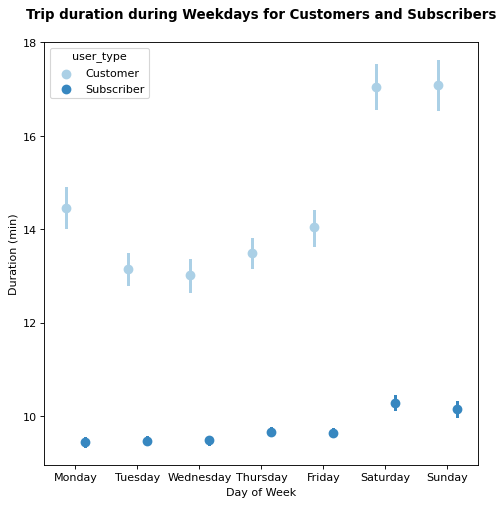

In [239]:
fig=plt.figure(figsize=(7,7), dpi= 80, facecolor='w', edgecolor='k')

plt.title("Trip duration during Weekdays for Customers and Subscribers", y = 1.04,fontweight='bold', color = 'black')

sns.pointplot(data=fordgobike_rides_clean, x='start_day_of_week', y='duration_minute', hue='user_type', dodge=0.3, linestyles="", palette = 'Blues');
plt.xlabel('Day of Week');
plt.ylabel('Duration (min)');

Subscribers have a similar duration through all weekdays. Customers made larger trips in terms on duration than subscribers, this difference is specially higher over the weekends.

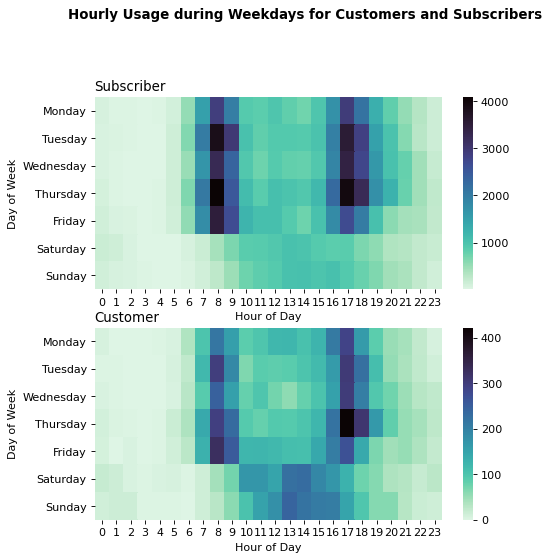

In [240]:

#adjusting the size
fig=plt.figure(figsize=(7,7), dpi= 80, facecolor='w', edgecolor='k')

#title
plt.suptitle("Hourly Usage during Weekdays for Customers and Subscribers", y = 1.04,fontweight='bold', color = 'black')
#subplot1
plt.subplot(2, 1, 1)
subscribers = fordgobike_rides_clean.query('user_type == "Subscriber"')
st_counts = subscribers.groupby(['start_day_of_week', 'start_hour']).size()
st_counts = st_counts.reset_index(name='count')
st_counts = st_counts.pivot(index='start_day_of_week', columns='start_hour', values='count')
sns.heatmap(st_counts, cmap='mako_r');
plt.title('Subscriber', loc='left');
plt.xlabel('Hour of Day');
plt.ylabel('Day of Week');


#subplot2
plt.subplot(2, 1, 2)
customers = fordgobike_rides_clean.query('user_type == "Customer"')
ct_counts = customers.groupby(['start_day_of_week', 'start_hour']).size()
ct_counts = ct_counts.reset_index(name='count')
ct_counts = ct_counts.pivot(index='start_day_of_week', columns='start_hour', values='count')
sns.heatmap(ct_counts, cmap='mako_r');
plt.title('Customer', loc='left');
plt.xlabel('Hour of Day');
plt.ylabel('Day of Week');

Susbcribers use the service mainly for commuting to work, since the most ammount of trips for them are done as 8am and 5pm which correspond with office hours. There are some customers that use the service for commuting as well. The amount of subscribers that use the service over the weekend is higher than the customer who use the service on weekends. However, the great majority of the customers use the service over the weekend. 

### Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest?

I extended the investigation about how the type of user and the categorical variables related to the start trip period (start_day_of_week and start_hour) play into the relationship between duration. These features helped to strengthen the relationships between them. The majority of subscribers use the service mainly over weekdays and it's their way to commute to the office. Customers use the service also for commuting to the office, but the majority of the customers use the service also during weekends from 10am till 6pm. However, the amount of subscribers who use the service on weekends is greater than the amount of customers who use the service on weekends.

### Were there any interesting or surprising interactions between features?

It's interesting how the type of user have a different behaviour in the way of using the service and it makes sense the relationship with the duration.